In [ ]:
# citations of orignals:
# """
# first two attempts were DCGANs (result were mode collapse)
# MNIST DCGAN by TensorFlow Authors: https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/dcgan.ipynb#scrollTo=ZBwyU6t2Wf3g
# Monet_ Dataset DCGAN architecture: https://www.kaggle.com/code/thuylinh225/generate-monet-images-using-dcgan
# naming convention for models: https://github.com/thashimoto1998/DCGAN/blob/master/dcgan.py
#
# third attempt is WGAN-GP (better results)
# WGAN-GP video: https://www.youtube.com/watch?v=pG0QZ7OddX4&list=PLhhyoLH6IjfwIp8bZnzX8QR30TRcHO8Va&index=5
# WGAN-GP paper: https://arxiv.org/abs/1704.00028
# WGAN-GP github: https://github.com/aladdinpersson/Machine-Learning-Collection/tree/master/ML/Pytorch/GANs/4.%20WGAN-GP
# """

In [ ]:
###############################
###         Updates         ###
###############################

#removed text cells
# added WGAN-GP
# all models save images as they train for GIFs
# added outputs folder to save GIFs
# figured out how to display colors for first_dcgan



In [1]:
import glob
import imageio
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import time
import matplotlib.image as mpimg

from IPython import display
from IPython.display import HTML
import zipfile
import re
from PIL import Image
import shutil
import matplotlib.animation as animation

In [2]:
import pandas as pd
from torchvision.transforms import v2
import tensorflow.keras as keras
from tensorflow.keras import layers
from tensorflow.keras import optimizers
from tensorflow.keras.utils import plot_model
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Flatten, Reshape
from tensorflow.keras.layers import BatchNormalization, Dropout
from tensorflow.keras.layers import ReLU, LeakyReLU, Activation
from tensorflow.keras.optimizers import Adam

In [3]:
#for WGAN-GP
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter

In [4]:
!pip install tensorflow_docs
import tensorflow_docs.vis.embed as embed

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.5/182.5 kB 3.0 MB/s eta 0:00:00


In [5]:
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.TPUStrategy(tpu)
except Exception as e:
    print("can't initialize tpu, using default, exception: " + str(e))
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE

can't initialize tpu, using default, exception: Please provide a TPU Name to connect to.
Number of replicas: 1


In [6]:
#Gather images
!git clone https://github.com/LyJacky/ImageGeneration.git

Cloning into 'ImageGeneration'...
remote: Enumerating objects: 366, done.
remote: Counting objects: 100% (61/61), done.
remote: Compressing objects: 100% (35/35), done.
remote: Total 366 (delta 24), reused 61 (delta 24), pack-reused 305
Receiving objects: 100% (366/366), 30.18 MiB | 12.48 MiB/s, done.
Resolving deltas: 100% (24/24), done.


In [7]:
# files = glob.glob(f"/content/ImageGeneration/monet_jpg/*.jpg")
data_path = glob.glob(f"/content/ImageGeneration/monet_jpg")

os.chdir(data_path[0])

data  = []
for file in os.listdir():
    if file.endswith(".jpg"):
        file_path = f"{data_path[0]}/{file}"
        img = mpimg.imread(file_path)
        data.append(img)

In [8]:
print(len(data))
print(data[0].shape)

300
(256, 256, 3)


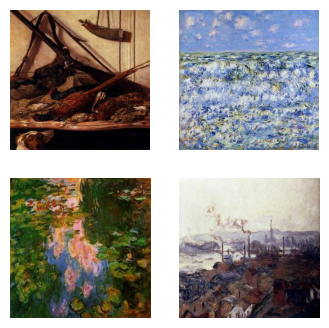

In [9]:
# show some samples

fig = plt.figure(figsize=(4,4))
for i, img in enumerate(data[0:4]):
    plt.subplot(2, 2, i+1)
    plt.imshow(data[i])
    plt.axis('off')
plt.show()

In [10]:
# # normalizing the images to [-1, 1]
# def normalize(image):
#   image = tf.cast(image, tf.float32)
#   image = (image / 127.5) - 1
#   return image

In [11]:
# def augment(image):
#   # image = tf.image.resize(image,[])
#   image = tf.image.random_flip_left_right(image)
#   image = tf.image.random_crop(image)
#   image = tf.image.random_brightness(image)
#   image = tf.image.random_saturation(image)
#   return image

In [12]:
# for val in data:
#   val = normalize(val)

#   # val = tf.image.resize(val, [,])
#   val = tf.image.random_flip_left_right(val)
#   val = tf.image.random_flip_up_down(val)
#   val = tf.image.random_brightness(val, 0.2)
#   # plt.imshow(val)
#   # plt.axis('off')
#   # plt.show()

#   # val = augment(val)


In [13]:
print(len(data))
print(data[0].shape)

300
(256, 256, 3)


In [14]:
# # show some samples
# plt.imshow(data[59])
# plt.axis('off')
# plt.show()

In [15]:
BATCH_SIZE = 64
BUFFER_SIZE = 300

In [16]:
train_dataset = tf.data.Dataset.from_tensor_slices(data).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
print(train_dataset)

<_BatchDataset element_spec=TensorSpec(shape=(None, 256, 256, 3), dtype=tf.uint8, name=None)>


In [ ]:
# modified generator

def make_generator_model():

    generator = Sequential(name="Generator")
    generator.add(Dense(16*16*512,
                        input_shape=(100,)))
    generator.add(Reshape((16,16,512)))

    # layer 2
    generator.add(Conv2DTranspose(filters=256, kernel_size=(6,6), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #layer 3
    generator.add(Conv2DTranspose(filters=128, kernel_size=(6,6), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #layer 4
    generator.add(Conv2DTranspose(filters=64, kernel_size=(6,6), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #layer 5
    generator.add(Conv2DTranspose(filters=32, kernel_size=(6,6), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #output
    generator.add(Conv2DTranspose(3, kernel_size=(6,6), activation='tanh', strides=(1,1), padding='same'))

    return generator

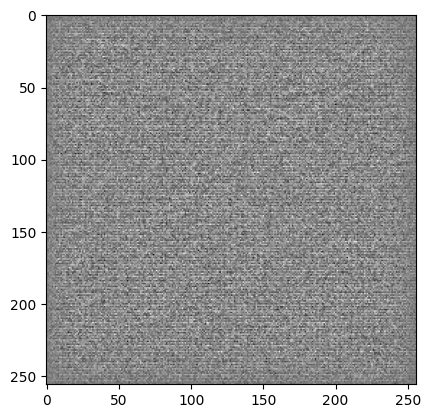

In [ ]:
# create noisy image sample
with strategy.scope():
    generator = make_generator_model()
    noise = tf.random.normal([1, 100])
    generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [ ]:
# Discriminator
def make_discriminator_model():

    discriminator = Sequential()

    #layer 1
    discriminator.add(Conv2D(filters=32, kernel_size=(6,6), strides=(2, 2), padding='same', input_shape=[256, 256, 3]))
    discriminator.add(LeakyReLU(0.2))

    #layer 2
    discriminator.add(Conv2D(filters=64, kernel_size=(6,6), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    #layer 3
    discriminator.add(Conv2D(filters=128, kernel_size=(6,6), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    #layer 4
    discriminator.add(Conv2D(filters=256, kernel_size=(6,6), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    # Flatten and Output Layers
    discriminator.add(Flatten())
    discriminator.add(Dropout(0.3))
    discriminator.add(Dense(1, activation='sigmoid'))
    # discriminator.add(Dense(1, activation='binary_crossentropy'))

    return discriminator


In [ ]:
with strategy.scope():
    discriminator = make_discriminator_model()
    decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.4999826]], shape=(1, 1), dtype=float32)


In [ ]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [ ]:
with strategy.scope():
    generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)

In [ ]:
checkpoint_dir = '/content/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [ ]:
!mkdir ../../outputs
!mkdir ../../outputs/first-DCGAN

In [ ]:
def generate_and_save_images(model, epoch, test_input):

  predictions = model(test_input, training=False)
  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      normalized_pred = predictions[i].numpy()
      normalized_pred = (normalized_pred[:, :, :] * 127.5 + 127.5).astype(np.uint8)
      plt.subplot(4, 4, i+1)
      plt.imshow(normalized_pred)
      plt.axis('off')

  plt.savefig('../../outputs/first-DCGAN/image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

In [ ]:
def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      train_step(image_batch)

    # Produce images for the GIF as you go
    generate_and_save_images(generator,
                             epoch + 1,
                             seed)
    # Debug: seed is Seed: tf.Tensor(2D rand num, shape(16,100))

    # Save the model every 15 epochs
    if (epoch + 1) % 15 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  generate_and_save_images(generator,
                           epochs,
                           seed)

In [ ]:
noise_dim = 100
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [ ]:
#training loop
EPOCHS = 25

In [ ]:
train(train_dataset, EPOCHS)

In [ ]:
first_dcgan_file = 'first_dcgan.gif'

with imageio.get_writer(first_dcgan_file, mode='I') as writer:
  filenames = glob.glob('../../outputs/first-DCGAN/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)

<ipython-input-34-f853b05f63b1>:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



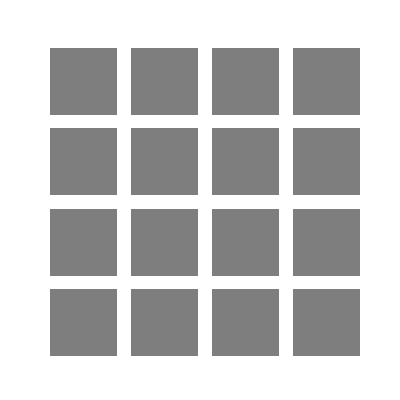

In [ ]:
embed.embed_file(first_dcgan_file)

In [ ]:
#############################
###    2nd DCGAN Attempt  ###
#############################

In [ ]:
generator2 = make_generator_model()
discriminator2 = make_discriminator_model()
with strategy.scope():
    generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)

noise_dim = 100
num_examples_to_generate = 25
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [ ]:
# !rm -r ../../outputs/second-DCGAN

In [ ]:
!mkdir ../../outputs/second-DCGAN

In [ ]:
class DCGAN_model:
    def __init__(self, noise_dim, EPOCHS, BATCH_SIZE, generator, discriminator, dataset):
        self.noise_dim = noise_dim
        self.EPOCHS = EPOCHS
        self.BATCH_SIZE = BATCH_SIZE
        self.generator = generator
        #self.discriminator = discriminator2
        self.dataset = dataset

    @tf.function
    def train(self, images):

    # Create random noise vector
        noise = tf.random.normal([images.shape[0], noise_dim])

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:

        # generate images use random noise vector
            generated_images = self.generator(noise, training=True)

            # use discriminator to evaluate the real and fake images
            real_output = discriminator(images, training=True)
            fake_output = discriminator(generated_images, training=True)
            # self.debug(real_output, fake_output)

            # compute generator loss and discriminator loss
            gen_loss = generator_loss(fake_output)
            disc_loss = discriminator_loss(real_output, fake_output)

            # Compute gradients
            gradients_of_generator = gen_tape.gradient(gen_loss, self.generator.trainable_variables)
            gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

            # Update optimizers
            generator_optimizer.apply_gradients(zip(gradients_of_generator, self.generator.trainable_variables))
            discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

        return (gen_loss + disc_loss) * 0.5

    # def debug(self, real_output, fake_output):
    #     # test =  real_output.numpy()
    #     # print("\t Discrimator real_output: ", test[0])
    #     print("\t Discrimator real_output: ", len(real_output))
    #     print("\t Discrimator real_output: ", type(real_output))
    #     print("\t Discrimator real_output: ", real_output.shape)
    #     print("\n")
    #     print("\t Discrimator fake_output: ", fake_output[0])

    @tf.function
    def distributed_train(self, images):
        per_replica_losses = strategy.run(self.train, args=(images,))
        return strategy.reduce(tf.distribute.ReduceOp.MEAN, per_replica_losses, axis=None)

    def generate_images(self):
        noise = tf.random.normal([self.BATCH_SIZE, self.noise_dim])
        predictions = self.generator.predict(noise)
        return predictions

    def generate_and_plot_images(self, epoch):
        # image = self.generate_images()
        predictions = self.generator.predict(seed)

        gen_imgs = 0.5 * predictions + 0.5
        fig = plt.figure(figsize=(5, 5))
        for i in range(25):
            plt.subplot(5, 5, i+1)
            plt.imshow(gen_imgs[i, :, :, :])
            plt.axis('off')
            plt.savefig('../../outputs/second-DCGAN/image_at_epoch_{:04d}.png'.format(epoch))
        plt.show()

    def save_images_with_seed_for_gif(self, epoch):
        predictions = self.generator.predict(seed)

        gen_imgs = 0.5 * predictions + 0.5
        # fig = plt.figure(figsize=(10, 10))
        # fig = plt.figure(figsize=(5, 5))
        for i in range(25):
            # plt.subplot(5, 5, i+1)
            plt.imshow(gen_imgs[i, :, :, :])
            # plt.axis('off')
            plt.savefig('../../outputs/second-DCGAN/image_at_epoch_{:04d}.png'.format(epoch))

    def train_loop(self):
        e_ls = []
        mean_ls = []
        for epoch in range(self.EPOCHS):
            start = time.time()

            total_loss = 0.0
            num_batches = 0

            for image_batch in self.dataset:
                loss = self.distributed_train(image_batch)
                total_loss += tf.reduce_mean(loss)
                num_batches += 1
            mean_loss = total_loss / num_batches

            # if (epoch+1) % 5 == 0:
            #     self.save_images_with_seed_for_gif(epoch)

            self.generate_and_plot_images(epoch)

            if (epoch+1) % 5 == 0:
                print('Time for epoch {} is {} sec, mean loss is {}'.format(epoch + 1, time.time()-start, mean_loss))

                e_ls.append(epoch+1)
                mean_ls.append(mean_loss)
        print("\nMean Loss for every 20 epochs: \n")
        table = pd.DataFrame({"Epoch": e_ls, "Mean Loss": np.array(mean_ls)})
        return table

In [ ]:
#training loop
EPOCHS = 300

In [ ]:
# train, visualize and print out the result for DCGAN model
gan1 = DCGAN_model(noise_dim, EPOCHS, BATCH_SIZE, generator2, discriminator2, train_dataset)
res1 = gan1.train_loop()

In [ ]:
res1

,Epoch,Mean Loss
0,5,6.622096
1,10,20.672092
2,15,14.054237
3,20,10.495397
4,25,2.156735
5,30,2.713376
6,35,2.847812
7,40,2.779436
8,45,6.543433
9,50,1.836165


In [ ]:
second_dcgan_file = 'second_dcgan.gif'

with imageio.get_writer(second_dcgan_file, mode='I') as writer:
  filenames = glob.glob('../../outputs/second-DCGAN/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)

<ipython-input-36-61fe5fd33e66>:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



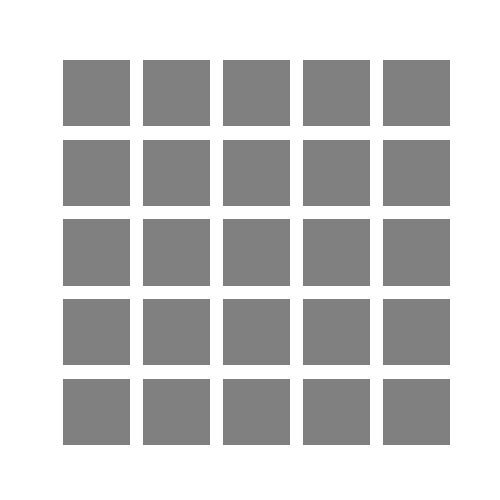

In [ ]:
embed.embed_file(second_dcgan_file)

In [ ]:
#############################
###    WGAN-GP Original    ###
#############################

In [17]:
def gradient_penalty(disc, real, fake, device="cpu"):
  BATCH_SIZE, C, H, W = real.shape
  epsilon = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)
  interpolated_images = real * epsilon + fake * (1 - epsilon)

  # calcuate discriminator scores
  mixed_scores = disc(interpolated_images)

  gradient = torch.autograd.grad(
      inputs = interpolated_images,
      outputs = mixed_scores,
      grad_outputs = torch.ones_like(mixed_scores),
      create_graph = True,
      retain_graph = True,
  )[0]

  gradient = gradient.view(gradient.shape[0], -1)
  gradient_norm = gradient.norm(2, dim=1)
  gradient_penalty = torch.mean((gradient - 1) ** 2)
  return gradient_penalty


In [18]:
class Discriminator(nn.Module):
  def __init__(self, channels_img, features_d):
    super(Discriminator, self).__init__()
    self.disc = nn.Sequential(
        nn.Conv2d(channels_img, features_d, kernel_size = 4, stride = 2, padding = 1),
        nn.LeakyReLU(0.2),

        #_block(in_channels, out_channels, kernel_size, stride, padding)
        self._block(features_d, features_d * 2, 4, 2, 1),
        self._block(features_d * 2, features_d * 4, 4, 2, 1),
        self._block(features_d * 4, features_d * 8, 4, 2, 1),

        # output is 4x4 (Conv2d turns into 1x1)
        nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0)
    )
  def _block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.Conv2d(
            in_channels,
            out_channels,
            kernel_size,
            stride,
            padding,
            bias=False,
        ),
        # nn.BatchNorm2d(out_channels),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2),
    )

  def forward(self, x):
    return self.disc(x)

In [19]:
class Generator(nn.Module):
  def __init__(self, channels_noise, channels_img, features_g):
    super(Generator, self).__init__()
    self.net = nn.Sequential(
        self._block(channels_noise, features_g * 16, 4, 1, 0),
        self._block(features_g * 16, features_g * 8, 4, 2, 1),
        self._block(features_g * 8, features_g * 4, 4, 2, 1),
        self._block(features_g * 4, features_g * 2, 4, 2, 1),
        nn.ConvTranspose2d(
            features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
        ),
        nn.Tanh(),
    )
  def _block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.ConvTranspose2d(
            in_channels,
            out_channels,
            kernel_size,
            stride,
            padding,
            bias=False,
        ),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
    )

  def forward(self, x):
    return self.net(x)


def initialize_weights(model):
    # Initializes weights according to the DCGAN paper
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)


def test():
    N, in_channels, H, W = 8, 3, 64, 64
    noise_dim = 100
    x = torch.randn((N, in_channels, H, W))
    disc = Discriminator(in_channels, 8)
    assert disc(x).shape == (N, 1, 1, 1), "Discriminator test failed"
    gen = Generator(noise_dim, in_channels, 8)
    z = torch.randn((N, noise_dim, 1, 1))
    assert gen(z).shape == (N, in_channels, H, W), "Generator test failed"


In [20]:
import torchvision.transforms as transforms

In [21]:
# hyperparameters

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
LEARNING_RATE = 1e-4
BATCH_SIZE = 32
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
FEATURES_DISC = 64
FEATURES_GEN = 64
DISC_ITERATIONS = 5
LAMBDA_GP = 10

transforms = transforms.Compose(
    [
        transforms.Resize(IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]
        ),
    ]
)

cuda


In [22]:
# checkpoints

def save_checkpoints(state, filename="monet_wgan_gp.pth.tar"):
  print("=> Saving checkpoint")
  torch.save(state, filename)

def load_checpoint(checkpoint, gen, disc):
  print("=> Loading checkpoint")
  gen.load_state_dict(checkpoint['gen'])   # generator
  disc.load_state_dict(checkpoint['disc']) # discriminator

In [23]:
def wgan_generate_images():
    noise = tf.random.normal([BATCH_SIZE, Z_DIM])
    # predictions = gen.predict(noise)
    fake = gen(noise)
    return fake

def wgan_generate_and_plot_images():
    image = wgan_generate_images()
    gen_imgs = 0.5 * image + 0.5
    fig = plt.figure(figsize=(10, 10))
    for i in range(25):
        plt.subplot(5, 5, i+1)
        plt.imshow(gen_imgs[i, :, :, :])
        plt.axis('off')
    plt.show()

In [24]:
!rm -r ../ImageGeneration/
!rm -r ../.ipynb_checkpoints/
!rm -r ../.git/

rm: cannot remove '../.ipynb_checkpoints/': No such file or directory


In [25]:
# !ls -a

In [26]:
# make sure to not have image_at_epoch_0010.jpg in the folder

dataset = datasets.ImageFolder(root="/content/ImageGeneration/", transform=transforms)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)
initialize_weights(gen)
initialize_weights(disc)

opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)
step = 0

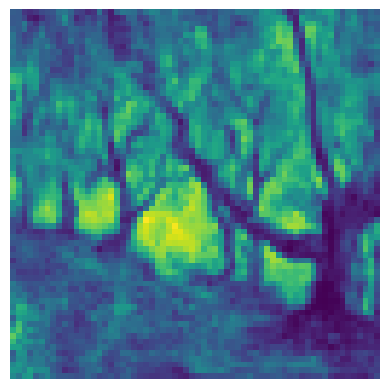

In [27]:
# show some samples
plt.imshow((dataset[1][0][2]))
plt.axis('off')
plt.show()

In [28]:
gen.train()
disc.train()

Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (5): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
  )
)

In [29]:
EPOCHS = 300

In [30]:
!PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True

In [31]:
!mkdir ../../outputs
!mkdir ../../outputs/first_wgan

In [32]:
noise_dim = 100
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)

 # keep seperate from training to not reset seed incase of running training cell > 1
seed = torch.randn(num_examples_to_generate, noise_dim, 1, 1).to(device)

In [ ]:
#training

for epoch in range(EPOCHS):
  for batch_idx, (real_img, _) in enumerate(dataloader):
    real = real_img.to(device)
    if len(real) < 32: # sometimes had tensor of size 12
        break

    for _ in range(DISC_ITERATIONS):
      noise = torch.randn(BATCH_SIZE, Z_DIM, 1, 1).to(device)
      fake = gen(noise)
      disc_real = disc(real).reshape(-1)
      disc_fake = disc(fake).reshape(-1)
      gp = gradient_penalty(disc, real, fake, device=device)
      loss_disc = (
          -(torch.mean(disc_real) - torch.mean(disc_fake)) + LAMBDA_GP*gp
      )
      disc.zero_grad()
      loss_disc.backward(retain_graph=True)
      opt_disc.step()

    output = disc(fake).reshape(-1)
    loss_gen = -torch.mean(output)
    gen.zero_grad()
    loss_gen.backward()
    opt_gen.step()

    #generate pics
    with torch.no_grad():
        # fake = gen(seed)
        img_grid_fake = torchvision.utils.make_grid(
          fake[:5], normalize=True
        )
        plt.imshow(img_grid_fake.cpu().detach().numpy().transpose(1, 2, 0))
        plt.axis('off')
        if epoch % 5 == 0 and batch_idx == 0:
          print(
              f"EPOCH [{epoch}/{EPOCHS}] Batch {batch_idx}/{len(dataloader)} Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
          )
          plt.show()

    # generate with seed and save GIF
    with torch.no_grad():
        if epoch % 2 == 0 and batch_idx == 0:
          fake = gen(seed)
          img_grid_fake = torchvision.utils.make_grid(
            fake[:5], normalize=True
          )
          plt.imshow(img_grid_fake.cpu().detach().numpy().transpose(1, 2, 0))
          plt.axis('off')
          plt.savefig('/content/outputs/first_wgan/image_at_epoch_{:04d}.png'.format(epoch + 1))

    step += 1

In [34]:
anim_file = 'wgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('../../outputs/first_wgan/image*.png')
  # filenames = glob.glob(f"/content/ImageGeneration/monet_jpg")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)

<ipython-input-34-5a2011aeacd1>:8: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



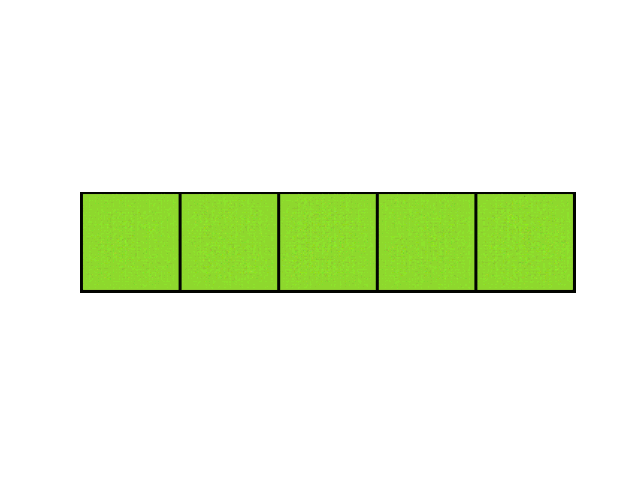

In [35]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

In [36]:
#############################
###    WGAN-GP Attempt    ###
#############################

In [37]:
"""
dataset = datasets.

- change cpu in gradient_penalty?
- different learning rates for disc, gen
- keep image size
DISC_ITERATIONS = 10
- padding = 2 # used to be 1
- kernel size = 5

FEATURES_DISC = 64?
FEATURES_GEN = 64?

init weights

Constrain Critic Weights:
After each mini-batch update, limit the critic model weights to a specific range (e.g., [-0.01, 0.01]).
This constraint prevents the critic from becoming too dominant and ensures stability during training.
"""

'\ndataset = datasets.\n\n- change cpu in gradient_penalty?\n- different learning rates for disc, gen\n- keep image size\nDISC_ITERATIONS = 10\n- padding = 2 # used to be 1\n- kernel size = 5\n\nFEATURES_DISC = 64?\nFEATURES_GEN = 64?\n\ninit weights\n\nConstrain Critic Weights:\nAfter each mini-batch update, limit the critic model weights to a specific range (e.g., [-0.01, 0.01]).\nThis constraint prevents the critic from becoming too dominant and ensures stability during training.\n'

In [38]:
def gradient_penalty(disc, real, fake, device="cpu"):
  BATCH_SIZE, C, H, W = real.shape
  epsilon = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)
  interpolated_images = real * epsilon + fake * (1 - epsilon)
  print('\tgradient_penalty.real: ', real) # debug
  print('\tgradient_penalty.epsilon: ', epsilon) # debug
  print('\tgradient_penalty.fake: ', fake) # debug
  print('\tgradient_penalty.(1 - epsilon): ', (1 - epsilon)) # debug
  print('\t\tgradient_penalty.equation: real', real, '* epsilon', epsilon, '+ fake', fake, '* 1-epsi', (1 - epsilon)) # debug
  print('\tgradient_penalty.interpolated_images: ', interpolated_images) # debug
  # print() # debug

  # calcuate discriminator scores
  mixed_scores = disc(interpolated_images)

  gradient = torch.autograd.grad(
      inputs = interpolated_images,
      outputs = mixed_scores,
      grad_outputs = torch.ones_like(mixed_scores),
      create_graph = True,
      retain_graph = True,
  )[0]

  gradient = gradient.view(gradient.shape[0], -1)
  gradient_norm = gradient.norm(2, dim=1)
  gradient_penalty = torch.mean((gradient - 1) ** 2)
  return gradient_penalty


In [39]:
class Discriminator(nn.Module):
  def __init__(self, channels_img, features_d):
    super(Discriminator, self).__init__()
    self.disc = nn.Sequential(
        #                    3,         64,
        nn.Conv2d(channels_img, features_d, kernel_size = 4, stride = 2, padding = 1),
        nn.LeakyReLU(0.2),

        #_block(in_channels, out_channels, kernel_size, stride, padding)
        #                   64,            128,
        self._block(features_d, features_d * 2, 4, 2, 1),
        #                   64,            128,
        self._block(features_d * 2, features_d * 4, 4, 2, 1),
        #                   256,            512,
        self._block(features_d * 4, features_d * 8, 4, 2, 1),

        # output is 4x4 (Conv2d turns into 1x1)
        #                    512,
        nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0)
    )
  def _block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.Conv2d(
            in_channels,
            out_channels,
            kernel_size,
            stride,
            padding,
            bias=False,
        ),
        # nn.BatchNorm2d(out_channels),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2),
    )

  def forward(self, x):
    return self.disc(x)

In [40]:
class Generator(nn.Module):
  def __init__(self, channels_noise, channels_img, features_g):
    super(Generator, self).__init__()
    self.net = nn.Sequential(
        self._block(channels_noise, features_g * 16, 4, 1, 0),
        self._block(features_g * 16, features_g * 8, 4, 2, 1),
        self._block(features_g * 8, features_g * 4, 4, 2, 1),
        self._block(features_g * 4, features_g * 2, 4, 2, 1),
        nn.ConvTranspose2d(
            features_g * 2, channels_img, kernel_size=4, stride=2, padding=2
        ),
        nn.Tanh(),
    )
  def _block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.ConvTranspose2d(
            in_channels,
            out_channels,
            kernel_size,
            stride,
            padding,
            bias=False,
        ),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
    )

  def forward(self, x):
    return self.net(x)


def initialize_weights(model):
    # Initializes weights according to the DCGAN paper
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)


def test():
    N, in_channels, H, W = 8, 3, 64, 64
    noise_dim = 100
    x = torch.randn((N, in_channels, H, W))
    disc = Discriminator(in_channels, 8)
    assert disc(x).shape == (N, 1, 1, 1), "Discriminator test failed"
    gen = Generator(noise_dim, in_channels, 8)
    z = torch.randn((N, noise_dim, 1, 1))
    assert gen(z).shape == (N, in_channels, H, W), "Generator test failed"


In [41]:
import torchvision.transforms as transforms

In [42]:
# hyperparameters

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
# LEARNING_RATE = 1e-4
DISCRIMINATOR_LEARNING_RATE = 1e-4
GENERATOR_LEARNING_RATE = 5e-5
BATCH_SIZE = 32
CHANNELS_IMG = 3
Z_DIM = 100
IMAGE_SIZE = 64
FEATURES_DISC = 64
FEATURES_GEN = 64
DISC_ITERATIONS = 10 # used to be 5
LAMBDA_GP = 10 # Loss weight for gradient penalty

transforms = transforms.Compose(
    [
        # transforms.Resize(IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]
        ),
    ]
)

cuda


In [43]:
# checkpoints

def save_checkpoints(state, filename="monet_wgan_gp.pth.tar"):
  print("=> Saving checkpoint")
  torch.save(state, filename)

def load_checpoint(checkpoint, gen, disc):
  print("=> Loading checkpoint")
  gen.load_state_dict(checkpoint['gen'])   # generator
  disc.load_state_dict(checkpoint['disc']) # discriminator

In [44]:
def wgan_generate_images():
    noise = tf.random.normal([BATCH_SIZE, Z_DIM])
    # predictions = gen.predict(noise)
    fake = gen(noise)
    return fake

def wgan_generate_and_plot_images():
    image = wgan_generate_images()
    gen_imgs = 0.5 * image + 0.5
    fig = plt.figure(figsize=(10, 10))
    for i in range(25):
        plt.subplot(5, 5, i+1)
        plt.imshow(gen_imgs[i, :, :, :])
        plt.axis('off')
    plt.show()

In [45]:
!rm -r ../ImageGeneration/
!rm -r ../.ipynb_checkpoints/
!rm -r ../.git/

rm: cannot remove '../ImageGeneration/': No such file or directory
rm: cannot remove '../.ipynb_checkpoints/': No such file or directory
rm: cannot remove '../.git/': No such file or directory


In [46]:
# make sure to not have image_at_epoch_0010.jpg in the folder

dataset = datasets.ImageFolder(root="/content/ImageGeneration/", transform=transforms)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)
initialize_weights(gen)
initialize_weights(disc)

opt_gen = optim.Adam(gen.parameters(), lr=GENERATOR_LEARNING_RATE, betas=(0.0, 0.9))
opt_disc = optim.Adam(disc.parameters(), lr=DISCRIMINATOR_LEARNING_RATE, betas=(0.0, 0.9))

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)
# writer_real = SummaryWriter(f"logs/real")
# writer_fake = SummaryWriter(f"logs/fake")
step = 0

In [47]:
# print(len(dataset))
# print(len(dataset[0]))
# print((dataset[0][0]), "\n")
# print((dataset[0][0][0]), "\n")
# print((dataset[0][0][0][0]), "\n")

In [48]:
# # show some samples
# fig = plt.figure(figsize=(4, 4))

# for i in range(4):
#   sample = dataset[i][0].numpy()

#   sample = sample.transpose(1,2,0)

#   sample = (sample[:, :, :] * 127.5 + 127.5).astype(np.int8)


#   plt.subplot(2, 2, i+1)
#   plt.imshow(sample)
#   plt.axis('off')
# plt.show()

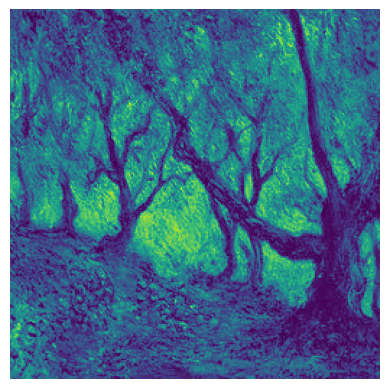

In [49]:
# show some samples
plt.imshow((dataset[1][0][2]))
plt.axis('off')
plt.show()

In [50]:
gen.train()
disc.train()

Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (5): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
  )
)

In [51]:
EPOCHS = 150

In [52]:
!PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True
!mkdir ../../outputs
!mkdir ../../outputs/second_wgan

mkdir: cannot create directory ‘../../outputs’: File exists


In [53]:
noise_dim = 100
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)

 # keep seperate from training to not reset seed incase of running training cell > 1
seed = torch.randn(num_examples_to_generate, noise_dim, 1, 1).to(device)

In [54]:
#training

for epoch in range(EPOCHS):
  for batch_idx, (real_img, _) in enumerate(dataloader):
    real = real_img.to(device)
    if len(real) < 32: # sometimes had tensor of size 12
        break

    for _ in range(DISC_ITERATIONS):
      #                           32,
      noise = torch.randn(BATCH_SIZE, Z_DIM, 1, 1).to(device)
      fake = gen(noise)
      disc_real = disc(real).reshape(-1)
      disc_fake = disc(fake).reshape(-1)
      gp = gradient_penalty(disc, real, fake, device=device)
      loss_disc = (
          -(torch.mean(disc_real) - torch.mean(disc_fake)) + LAMBDA_GP*gp
      )
      disc.zero_grad()
      loss_disc.backward(retain_graph=True)
      opt_disc.step()

    output = disc(fake).reshape(-1)
    loss_gen = -torch.mean(output)
    gen.zero_grad()
    loss_gen.backward()
    opt_gen.step()

    #generate pics
    with torch.no_grad():
        # fake = gen(seed)
        img_grid_fake = torchvision.utils.make_grid(
          fake[:5], normalize=True
        )
        plt.imshow(img_grid_fake.cpu().detach().numpy().transpose(1, 2, 0))
        plt.axis('off')
        if epoch % 5 == 0 and batch_idx == 0:
          print(
              f"EPOCH [{epoch}/{EPOCHS}] Batch {batch_idx}/{len(dataloader)} Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
          )
          plt.show()

    # generate with seed and save GIF
    with torch.no_grad():
        if epoch % 2 == 0 and batch_idx == 0:
          fake = gen(seed)
          img_grid_fake = torchvision.utils.make_grid(
            fake[:5], normalize=True
          )
          plt.imshow(img_grid_fake.cpu().detach().numpy().transpose(1, 2, 0))
          plt.axis('off')
          plt.savefig('/content/outputs/second_wgan/image_at_epoch_{:04d}.png'.format(epoch + 1))

    step += 1

RuntimeError: Calculated padded input size per channel: (3 x 3). Kernel size: (4 x 4). Kernel size can't be greater than actual input size

In [ ]:
anim_file = 'wgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('../../outputs/first_wgan/image*.png')
  # filenames = glob.glob(f"/content/ImageGeneration/monet_jpg")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)

In [ ]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)